# Практика 1. Базовые операции с изображениями

На первом этапе нам необходимо подключить библиотеки. Мы будем использовать пока 2 библиотеки, это Numpy (библиотека математических вычислений https://numpy.org/doc/stable/ )  и OpenCV (бибилиотека компьютерного зрения) (https://docs.opencv.org/4.12.0/)

In [ ]:
import cv2
import numpy as np


Этап 1. Загрузка изображений. В принципе есть 2 варианта получения изображений для обратки. Это подгрузка сохраненных единичных изображений и получение изображений из видео/видеопотока. ПРи этом т.к. сам видеопоток или видео это набор изображений во времени, получать вы их так же будете последовательно. Если видеопоток получаеться с камеры (для этого используеться функция cv2.VideoCapture(0), где в скобках указываеться номер устройства) то изображения будут выдаватся в текущй момент времени (в момент запроса), а если из видео, то последовательно друг за другом. На данном занятии мы будем работать с вами с единичным изображение. Скачаем классическое изображение Лены (https://en.wikipedia.org/wiki/Lenna) и сохраним его в папку нашего проекта. Дополнительно все файлы скидываю в свой диск (https://drive.google.com/drive/folders/1W29fTcJUcB9cB8H5ZZLzvZGXpKvnu7Qo?usp=sharing )

для того, чтобы нам подгрузить нашу картинку воспользуемся командой cv2.imread(путь до файла)

In [ ]:
image=cv2.imread('/content/drive/MyDrive/Colab Notebooks/Данные_CV/Lenna.png')

Обычно в библиотеке OpenCV для вывода изображения на экран используеться команда  cv.imshow(). Однако в колабе она не работает, чтобы вывести изображение на экран достаточно просто написать название объекта где храниться изображение

array([[[125, 137, 226],
        [125, 137, 226],
        [133, 137, 223],
        ...,
        [122, 148, 230],
        [110, 130, 221],
        [ 90,  99, 200]],

       [[125, 137, 226],
        [125, 137, 226],
        [133, 137, 223],
        ...,
        [122, 148, 230],
        [110, 130, 221],
        [ 90,  99, 200]],

       [[125, 137, 226],
        [125, 137, 226],
        [133, 137, 223],
        ...,
        [122, 148, 230],
        [110, 130, 221],
        [ 90,  99, 200]],

       ...,

       [[ 60,  18,  84],
        [ 60,  18,  84],
        [ 58,  27,  92],
        ...,
        [ 84,  73, 173],
        [ 76,  68, 172],
        [ 79,  62, 177]],

       [[ 57,  22,  82],
        [ 57,  22,  82],
        [ 62,  32,  96],
        ...,
        [ 79,  70, 179],
        [ 81,  71, 181],
        [ 81,  74, 185]],

       [[ 57,  22,  82],
        [ 57,  22,  82],
        [ 62,  32,  96],
        ...,
        [ 79,  70, 179],
        [ 81,  71, 181],
        [ 81,  74, 185]]], dtype=uint8)
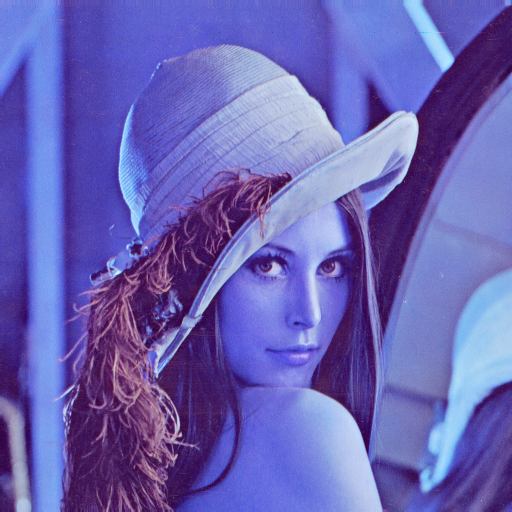

In [ ]:
image

Мы с вами видим, что по какой то причине изображение не соответсвует тому, что мы с вами привыкли. Все дело в том, что opencv отображает по умолчанию изображения в RGB фотрмате, а в BGR, то есть немного наоборот. Давайте исправим данную оплошность. Вомпользуемся встроенной функцией перевода изображений в разные цветовые пространства: cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
Данная функция в качестве аргументов принимает 2 значения, непосредственно фотографию которая приходит на вход и тип преобразования, при этом типы преобразований указываються как изначальный формат изображений, так и конечный формат. Более подробно о форматах преобразования вы можете посмотреть, по ссылке: https://docs.opencv.org/3.4/d8/d01/group__imgproc__color__conversions.html
давайте преобразуем данное изображение из BGR формата в RGB

array([[[226, 137, 125],
        [226, 137, 125],
        [223, 137, 133],
        ...,
        [230, 148, 122],
        [221, 130, 110],
        [200,  99,  90]],

       [[226, 137, 125],
        [226, 137, 125],
        [223, 137, 133],
        ...,
        [230, 148, 122],
        [221, 130, 110],
        [200,  99,  90]],

       [[226, 137, 125],
        [226, 137, 125],
        [223, 137, 133],
        ...,
        [230, 148, 122],
        [221, 130, 110],
        [200,  99,  90]],

       ...,

       [[ 84,  18,  60],
        [ 84,  18,  60],
        [ 92,  27,  58],
        ...,
        [173,  73,  84],
        [172,  68,  76],
        [177,  62,  79]],

       [[ 82,  22,  57],
        [ 82,  22,  57],
        [ 96,  32,  62],
        ...,
        [179,  70,  79],
        [181,  71,  81],
        [185,  74,  81]],

       [[ 82,  22,  57],
        [ 82,  22,  57],
        [ 96,  32,  62],
        ...,
        [179,  70,  79],
        [181,  71,  81],
        [185,  74,  81]]], dtype=uint8)
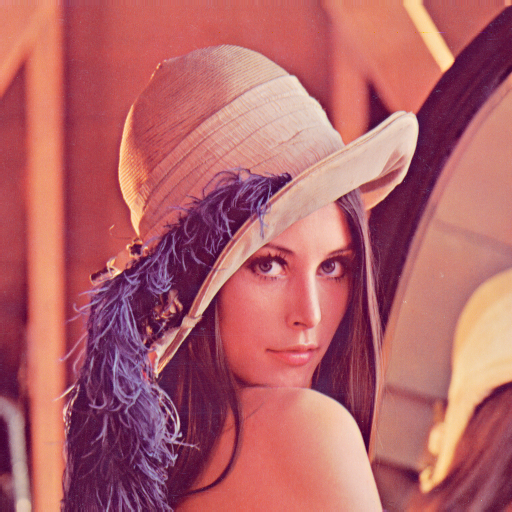

In [ ]:
image_RGB = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_RGB

Мы получили именно такое изображение которое мы и хотели. Однако давайте попробуем разобраться более детально с этим преобразованием, и как мы могли бы его сделать подругому. Для этого познакомимся с 2-мя функциями cv2.split(image) и cv2.merge(вектор объединения). Первая функция может разложить любое изображения, на отдельные каналы. При этом абсолютно не важно какая размерность цветового пространства, которым описано изображение. Функция определяет размерность изображения и записывает данные в отдельные переменные по каналам. Конечно, вам нужно данные переменные задать. Поскольку у нас формат RBG (то есть 3 канала) мы это так и зададим.

array([[137, 137, 137, ..., 148, 130,  99],
       [137, 137, 137, ..., 148, 130,  99],
       [137, 137, 137, ..., 148, 130,  99],
       ...,
       [ 18,  18,  27, ...,  73,  68,  62],
       [ 22,  22,  32, ...,  70,  71,  74],
       [ 22,  22,  32, ...,  70,  71,  74]], dtype=uint8)
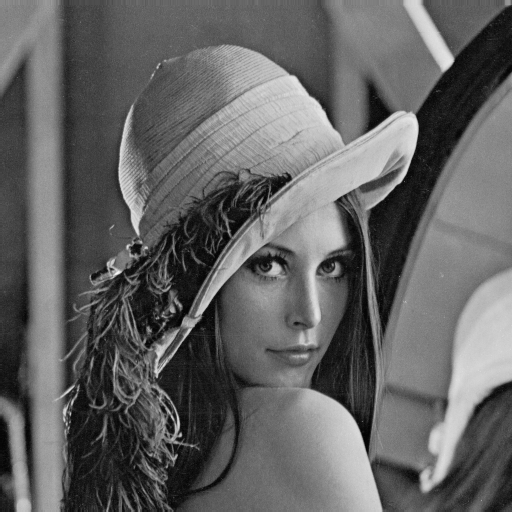

In [ ]:
r,g,b = cv2.split(image_RGB)
g

И так, мы с вами получили черно-белое изображение, а чтоже оно описывает не совсем понятно. Давайте посмотрим на другом примере изображения https://www.google.com/url?sa=i&url=https%3A%2F%2Fwww.cysend.com%2Fru%2Fproduct-page%2F24210&psig=AOvVaw08cd5RBGtRN6V-_wZbi3V8&ust=1756537910209000&source=images&cd=vfe&opi=89978449&ved=0CBUQjRxqFwoTCMiikeW7r48DFQAAAAAdAAAAABAL скачайте и добавьте данное изображение в папку ( запрос в гугле smyk)

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
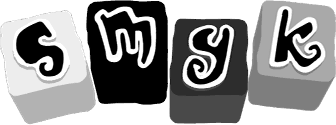

In [ ]:
image2=cv2.imread('/content/drive/MyDrive/Colab Notebooks/Данные_CV/images.png')
image2_RGB = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
r,g,b = cv2.split(image2_RGB)
r

Что мы видим, цвет кубиков меняеться в зависимости от канала. Это происходит потому, что каждый канал описываеться значениями от 0 до 255 (8 битное описание) при этом, 0-  отсутсвие данного канала в пикселе изображения, а 255 максимальное значение. Если вывести красный канал (r), то наиболее белым будет красный кубие, а остальные более темные. Если зеленый, то третий кубик, а если синий, то 2 кубик.

Вернемся к нашей задаче, как же используя разбюития мы могли бы поменять каналы избражения. Все просто используем функцию merge и поменяем порядок каналов.

In [ ]:
image2_RGB_v=cv2.merge([r,g, b])
image2_RGB_v2=cv2.merge([b,b, g])

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
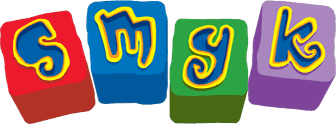

In [ ]:
image2_RGB_v

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]], dtype=uint8)
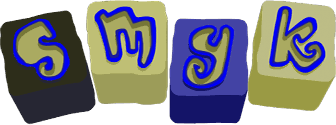

In [ ]:
image2_RGB_v2

А можем ли мы объединить 2 канала? Для 3-х канального изображения нет. Но давайте создадим пустой канал и добавим его

In [ ]:
zero_channel = np.zeros(r.shape, dtype='uint8')

np.zeros функиця библиотеки numpy которая создает заполненную нулями массив, размером как то, что мы передадим на вход функции, и типом данных, который мы зададим.
Давайте создадим изображение, используя только 2 канала с информацией и 1 нулевой канал.

array([[[255,   0,   0],
        [255,   0,   0],
        [255,   0,   0],
        ...,
        [255,   0,   0],
        [255,   0,   0],
        [255,   0,   0]],

       [[255,   0,   0],
        [255,   0,   0],
        [255,   0,   0],
        ...,
        [255,   0,   0],
        [255,   0,   0],
        [255,   0,   0]],

       [[255,   0,   0],
        [255,   0,   0],
        [255,   0,   0],
        ...,
        [255,   0,   0],
        [255,   0,   0],
        [255,   0,   0]],

       ...,

       [[255,   0,   0],
        [255,   0,   0],
        [255,   0,   0],
        ...,
        [255,   0,   0],
        [255,   0,   0],
        [255,   0,   0]],

       [[255,   0,   0],
        [255,   0,   0],
        [255,   0,   0],
        ...,
        [255,   0,   0],
        [255,   0,   0],
        [255,   0,   0]],

       [[255,   0,   0],
        [255,   0,   0],
        [255,   0,   0],
        ...,
        [255,   0,   0],
        [255,   0,   0],
        [255,   0,   0]]], dtype=uint8)
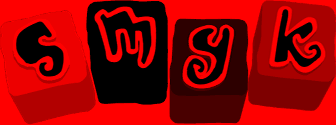

In [ ]:
image2_RGB_v3=cv2.merge([r,zero_channel, zero_channel])
image2_RGB_v3

Ответте на вопрос, почему такой результат мы получили? Проделайте самостоятельно операции с другими каналами.

Хорошо, вроде разобрались, а как мне сделать так, чтобы на изображении был выделен только кубик одного цвета? То есть я хочу, чтобы например красный кубик был виден, а другие кубики были закрашены белым.
Это более сложная операция которая называеться бинаризация. Давайте разберемся и реализуем ее самостоятельно без использования библиотеки Opencv. Для начала быстро посмотрим, как нам работать с элементами массива.

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
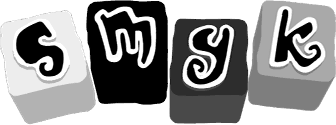

In [ ]:
r.shape

i, j = r.shape
r[10][87]
range(len(r))
r

Напишем простую програмку, пробежимся по всем элементам нашего массива и оставим только те пиксели, где значение красного больше чем значение других цветов.

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)
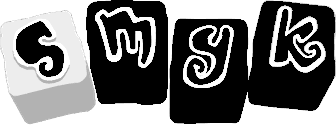

In [ ]:
r_new = np.zeros(r.shape, dtype='uint8')
for i in range(len(r)):
  for j in range(len(r[i])):
    if r[i][j]<170:
      r_new[i][j]=0
    else:
      r_new[i][j]=r[i][j]
r_new


И так, вот мы по суте выделили красный квадратик, но есть ряд но, в опервых белый фон, тоже содержит много красного цвета (как и любого другого), во вторых контуры букв так же выделились, как это исправить?

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
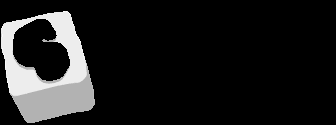

In [ ]:
r_new2 = np.zeros(r.shape, dtype='uint8')
for i in range(len(r)):
  for j in range(len(r[i])):
    if (r[i][j]/g[i][j])>3 and (r[i][j]/b[i][j])>3 and g[i][j]>10 and b[i][j]>10:
      r_new2[i][j]=r[i][j]
    else:
      r_new2[i][j]=0
r_new2


Вот у нас и получилось выделить исключительно только искомый кубик.
Давайте попробуем вернуть цвет нашему изображению.

array([[[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255]],

       [[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255]],

       [[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255]],

       ...,

       [[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255]],

       [[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255]],

       [[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255]]], dtype=uint8)
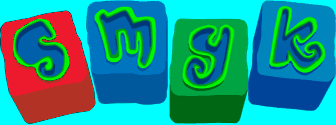

In [ ]:
image2_RGB_v4=cv2.merge([r_new2,g, b])
image2_RGB_v4

Получили ли мы то, что хотели? Нет. Мы хотели чтобы у нас был исключительно красный кубик на изображении.

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
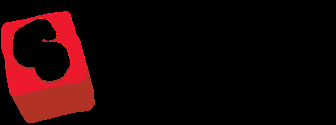

In [ ]:
image2_RGB_v5= cv2.bitwise_and(image2_RGB_v,image2_RGB_v, mask= r_new2)
image2_RGB_v5

Это можно реализовать при помощи функции реализованной ранее, но заменив сохранение из изначального цветного изображения

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
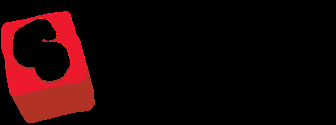

In [ ]:
r_new3 = np.zeros(image2_RGB_v.shape, dtype='uint8')
for i in range(len(r)):
  for j in range(len(r[i])):
    if (r[i][j]/g[i][j])>3 and (r[i][j]/b[i][j])>3 and g[i][j]>10 and b[i][j]>10:
      r_new3[i][j]=image2_RGB_v[i][j]
    else:
      r_new3[i][j]=0
r_new3

Мы можем использовать внутренние функции opencv для тогшо чтобы выделять объекты. Например функцию inRange. она оставит только те пиксели которые попали в интересующий нас диапазон значений.


array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
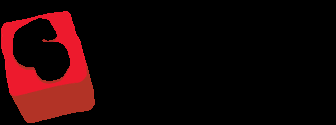

In [ ]:
lower = np.array([20,0,0])
upper = np.array([255,70,70])
image2_RGB_v6=cv2.inRange(image2_RGB_v,lower,upper)
image2_RGB_v5= cv2.bitwise_and(image2_RGB_v,image2_RGB_v, mask= image2_RGB_v6)
image2_RGB_v5

Еще одна похожая на inRange функция это функция threshold. Однака данная функция работает только с одноканальным изображением. То есть либо нужно привести в одноканальный формат изображение, например в черно-белый формат (grey-scale) либо работать по каналам отдельно и потом объединять. Я сделаю функцию только по каждому каналу отдельно, а после объединю.


array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)
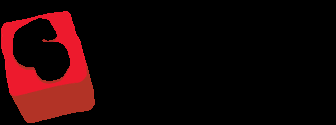

In [ ]:
r,g,b=cv2.split(image2_RGB)
ret,thresh_r = cv2.threshold(r,21, 255,cv2.THRESH_BINARY)
ret,thresh_g = cv2.threshold(g,52, 255, cv2.THRESH_BINARY_INV)
ret,thresh_b = cv2.threshold(b,50, 255,cv2.THRESH_BINARY_INV)
MASK=cv2.bitwise_and(thresh_r,thresh_g, thresh_b)
image2_RGB_v7= cv2.bitwise_and(image2_RGB,image2_RGB, mask= MASK)
image2_RGB_v7

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
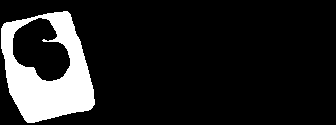

In [ ]:
MASK

Изображение такого типа, как приведено на рисунке, называется бинарное изображение. Потому, что значения пикселей изображений принимают только 2 значениия (0 или 255), что по сути являеться логическими вариантами true и false. А это значит, что к таким изображениям можно (логично) применять логические операции, или и, не и т.п.
Подобные операции получили название морфологические функции/ операции. Таких операций 4: Расширение (dilate), сужение (erode), открытие и закрытие (morphologyEx). рассмотрим результаты применения данных функций.Чтобы лучше понять операции, чуть чуть сделаем хуре результаты бинаризации

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
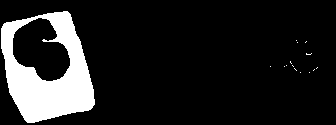

In [ ]:
ret,thresh_r = cv2.threshold(r,15, 255,cv2.THRESH_BINARY)
ret,thresh_g = cv2.threshold(g,65, 255, cv2.THRESH_BINARY_INV)
ret,thresh_b = cv2.threshold(b,60, 255,cv2.THRESH_BINARY_INV)
MASK=cv2.bitwise_and(thresh_r,thresh_g, thresh_b)
MASK

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
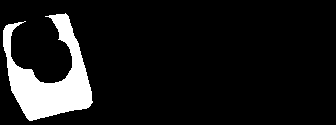

In [ ]:
Mask_er=cv2.erode(MASK,np.ones((5,5),np.uint8), iterations=1)
Mask_er

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [  0, 255, 255, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0,   0,   0],
       [  0,   0, 255, ...,   0,   0,   0]], dtype=uint8)
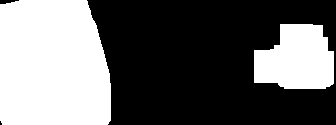

In [ ]:
Mask_dil=cv2.dilate(MASK,np.ones((9,9),np.uint8), iterations=4)
Mask_dil

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
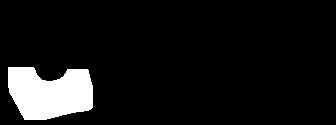

In [ ]:
Mask_open=cv2.morphologyEx(MASK, cv2.MORPH_OPEN, np.ones((5,5),np.uint8), iterations=5)
Mask_open

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
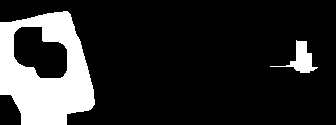

In [ ]:
Mask_close=cv2.morphologyEx(MASK, cv2.MORPH_CLOSE, np.ones((5,5),np.uint8),iterations=5)
Mask_close

Самостоятельно настройте операции таким образом, чтобы остался только красный квадратик.

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]], dtype=uint8)
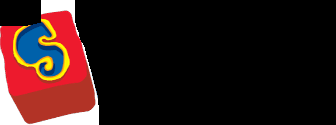

In [ ]:
Mask_open=cv2.morphologyEx(MASK, cv2.MORPH_OPEN, np.ones((3,3),np.uint8))
Mask_dil=cv2.dilate(Mask_open,np.ones((8,8),np.uint8), iterations=4)
morf=cv2.morphologyEx(Mask_dil, cv2.MORPH_CLOSE, np.ones((9,9),np.uint8),iterations=1 )
final=cv2.erode(morf,np.ones((6,6),np.uint8), iterations=6)
image2_RGB_v8= cv2.bitwise_and(image2_RGB_v,image2_RGB_v, mask= final)
image2_RGB_v8

# Практика 2. Фильтрация

На данном занятии мы научимся обрабатывать фотографии, и бороться с 2-мя проблемами: ШУМ и освещение.  https://drive.google.com/drive/folders/1W29fTcJUcB9cB8H5ZZLzvZGXpKvnu7Qo?usp=sharing Для начала посмотрим работу фильтров на примере Лены.

array([[[227, 140, 128],
        [255, 255,   0],
        [224, 137, 138],
        ...,
        [235, 148, 121],
        [221, 128, 113],
        [255, 255,   0]],

       [[255, 255,   0],
        [227, 140, 128],
        [224, 137, 138],
        ...,
        [235, 148, 121],
        [221, 128, 113],
        [202,  95,  94]],

       [[227, 140, 128],
        [227, 140, 128],
        [255, 255,   0],
        ...,
        [235, 148, 121],
        [221, 128, 113],
        [202,  95,  94]],

       ...,

       [[ 87,  18,  61],
        [ 87,  18,  61],
        [ 92,  19,  59],
        ...,
        [174,  71,  84],
        [172,  67,  77],
        [178,  67,  78]],

       [[ 81,  14,  59],
        [255, 255,   0],
        [101,  28,  63],
        ...,
        [255, 255,   0],
        [181,  72,  82],
        [187,  72,  79]],

       [[255, 255,   0],
        [ 81,  14,  59],
        [101,  28,  63],
        ...,
        [255, 255,   0],
        [181,  72,  82],
        [187,  72,  79]]], dtype=uint8)
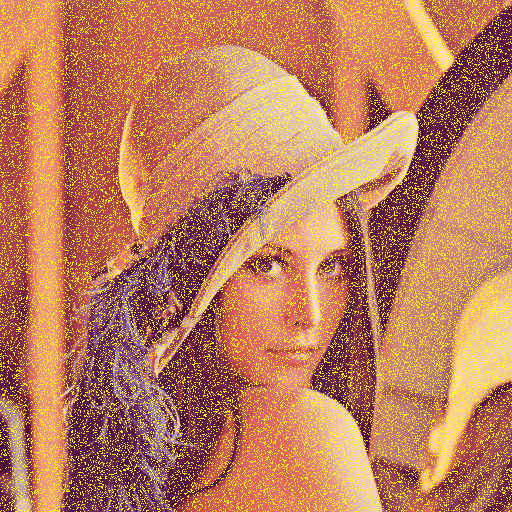

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
#image_noize=cv2.imread('/content/drive/MyDrive/Colab Notebooks/Данные_CV/Noize.png')
image_noize=cv2.imread('/content/drive/MyDrive/Colab Notebooks/Данные_CV/Lena2.png')
image_noize = cv2.cvtColor(image_noize, cv2.COLOR_BGR2RGB)
image_noize

Из лекции мы уже с вами должны знать, что на изображениях бывает 2 вада шума (наиболее часто конечно, но не всегда), это так называемый шум связанный с измерениями, который наиболее часто подвержен нормальному закону распределния (Гаусов шум), и шум связанный с засветами и проблемами матрицы (Импульсный шум, или шум вида "Соль и Перец"). Для начала необходимо определиться что за вид шума на изображении. А потом уже применять соответсвующий фильтр. ЧТобы проанализировать какой же у нас вид шума (если вам это неясно сразу), давайте построим значения любой строчки изображения в пространстве. Для этого разложим на каналы наше изображения и при помощи библиотеки matplotlib.pyplot построим данную развертку

512
512


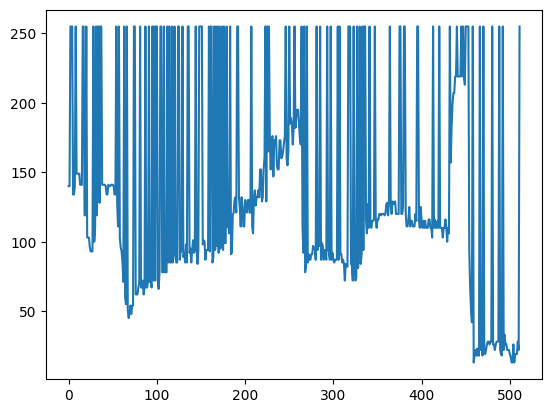

In [ ]:
r,g,b = cv2.split(image_noize)
print(len(g))
print(len(g[56]))
plt.plot(g[56])

И так мы видим всплески, причем на каналах R и G всплески к максимальным значениям, а для канала blue к минимальным, что же это за вид шума? Рассмотрим 2 основных вида фильтра и как они влияют на изображения: Медианный фильтр (medianBlur) и ФИльтр Гауса (GaussianBlur).  Функция medianBlur в качестве обязательных аргументав использует только входное изображение и размер фильтра, который всегда задаеться числом и всегда нечетным. Почему же одно число? По сути окно фильтрации которое реализовано операцией свертки всегда используеться квадратное и поэтому достаточно одного числа для задания фильтра.

array([[[227, 140, 128],
        [227, 140, 128],
        [227, 140, 128],
        ...,
        [235, 148, 121],
        [235, 148, 113],
        [235, 148,  94]],

       [[227, 140, 128],
        [227, 140, 128],
        [227, 140, 128],
        ...,
        [235, 148, 121],
        [235, 148, 113],
        [235, 148,  94]],

       [[227, 140, 128],
        [227, 140, 128],
        [227, 140, 128],
        ...,
        [235, 148, 113],
        [235, 148, 104],
        [221, 128,  94]],

       ...,

       [[ 92,  19,  59],
        [ 92,  22,  61],
        [ 92,  22,  61],
        ...,
        [172,  67,  79],
        [178,  71,  79],
        [178,  71,  79]],

       [[ 92,  22,  59],
        [ 92,  28,  59],
        [ 92,  22,  59],
        ...,
        [174,  72,  79],
        [181,  72,  79],
        [181,  72,  79]],

       [[ 92,  22,  59],
        [101,  28,  59],
        [ 92,  22,  59],
        ...,
        [181,  72,  79],
        [187,  72,  79],
        [187,  72,  79]]], dtype=uint8)
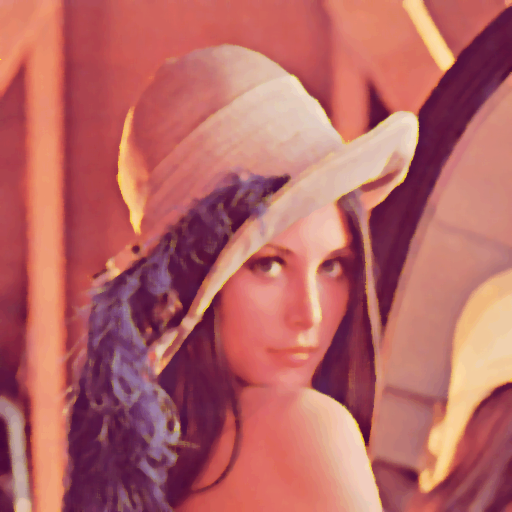

In [ ]:
median_rgb=cv2.medianBlur(image_noize,7)
median_rgb


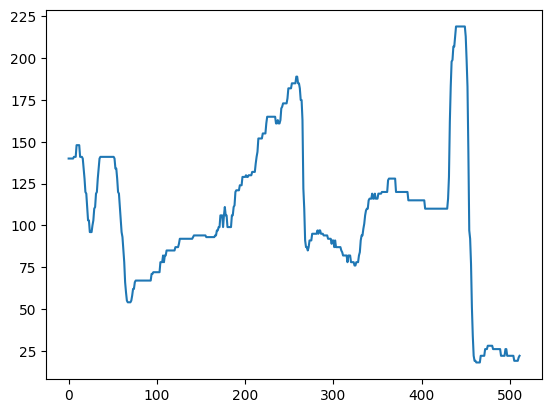

In [ ]:
r,g,b = cv2.split(median_rgb)
plt.plot(g[56])

Фильтра гауса реализован функцией GaussianBlur и в качестве параметров требует входное изображение, рамер фильтра (двумерный размер) и параметр дисперсии, то есть величины разброса значений. Подробнее про нормальное распределение, можно почитать по ссылке: https://ru.wikipedia.org/wiki/%D0%9D%D0%BE%D1%80%D0%BC%D0%B0%D0%BB%D1%8C%D0%BD%D0%BE%D0%B5_%D1%80%D0%B0%D1%81%D0%BF%D1%80%D0%B5%D0%B4%D0%B5%D0%BB%D0%B5%D0%BD%D0%B8%D0%B5

array([[[235, 175,  90],
        [234, 169,  97],
        [232, 162, 102],
        ...,
        [228, 141, 111],
        [225, 136, 108],
        [224, 136, 107]],

       [[235, 177,  89],
        [235, 176,  89],
        [233, 166,  98],
        ...,
        [228, 140, 111],
        [225, 136, 108],
        [224, 135, 107]],

       [[236, 181,  84],
        [236, 180,  84],
        [233, 168,  96],
        ...,
        [228, 139, 111],
        [224, 135, 109],
        [224, 134, 108]],

       ...,

       [[111,  51,  54],
        [116,  58,  52],
        [122,  65,  51],
        ...,
        [188, 104,  64],
        [186,  95,  67],
        [185,  93,  68]],

       [[126,  70,  48],
        [135,  84,  44],
        [132,  79,  47],
        ...,
        [192, 109,  64],
        [193, 106,  64],
        [194, 110,  63]],

       [[128,  73,  47],
        [137,  88,  43],
        [134,  81,  46],
        ...,
        [191, 104,  66],
        [192, 102,  66],
        [196, 113,  62]]], dtype=uint8)
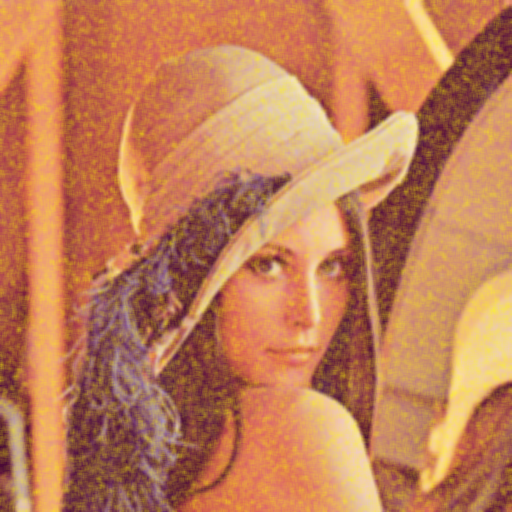

In [ ]:
gausian_rgb=cv2.GaussianBlur(image_noize,[5,5],3)
gausian_rgb

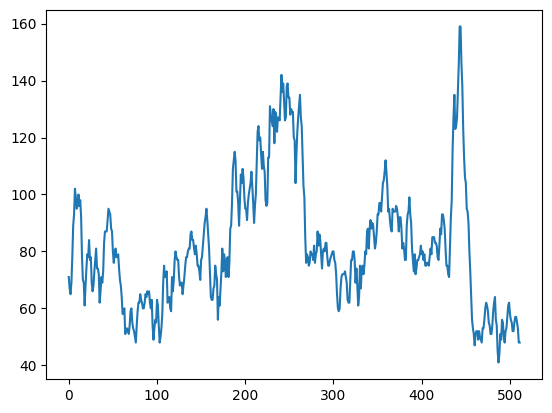

In [ ]:
r,g,b = cv2.split(gausian_rgb)
plt.plot(b[56])

Из результатов видно, что с шумом вида "Соль и перец", как и с импульсным шумом эффективно справляеться Медианный фильтр!. Рассмотрим другой пример изображения. КОторый тоже можно загрузить с гугл диска. На даннолм изображении, в отличии от предыдущего шум представлен не просто выбросами, а небольшой рябью в отклонении от реального значения. Такой шум достигается за счет погрешности измерительной матрицы и средств обработки (в том числе дискретизации ацп)

array([[[104,  97,  99],
        [128, 115, 103],
        [ 90,  77,  93],
        ...,
        [139, 108, 101],
        [ 73,  63,  58],
        [137,  80,  41]],

       [[114,  81, 105],
        [ 87,  49,  54],
        [102,  86,  86],
        ...,
        [115,  85,  95],
        [ 74,  70,  83],
        [103, 106,  90]],

       [[ 70,  74,  54],
        [100, 109,  88],
        [102,  76,  87],
        ...,
        [102,  80, 107],
        [104, 100,  75],
        [125,  95,  88]],

       ...,

       [[ 60, 108, 115],
        [ 89, 141, 115],
        [ 73, 109, 128],
        ...,
        [141,  23,  72],
        [173,  15,  64],
        [185,   4,  51]],

       [[ 93,  95, 121],
        [ 69, 126, 125],
        [ 70, 125, 138],
        ...,
        [176,  21,  60],
        [183,  37,  90],
        [187,  24,  65]],

       [[ 63, 101, 129],
        [ 30, 125, 134],
        [138, 129, 134],
        ...,
        [168,  69,  83],
        [198,  27,  51],
        [158,  14,  47]]], dtype=uint8)
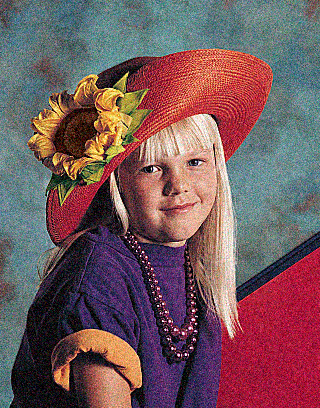

In [ ]:
image_noize=cv2.imread('/content/drive/MyDrive/Colab Notebooks/Данные_CV/Port_noisy_big.png')
image_noize=cv2.cvtColor(image_noize, cv2.COLOR_BGR2RGB)
image_noize

Для анализа вида шума, построим нашу развертку одной строчки. И что же мы увидим.

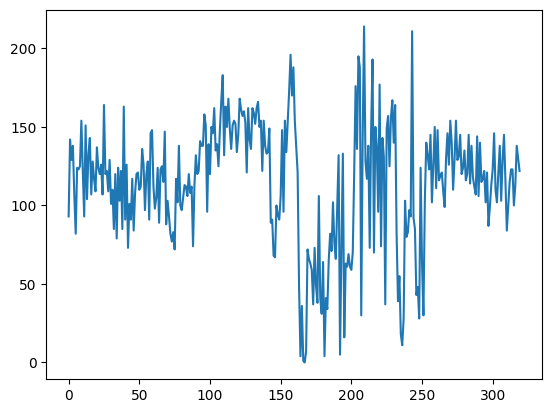

In [ ]:
r,g,b = cv2.split(image_noize)
plt.plot(g[56])

Да верно. Значения наших каналов уже не стремяться к 0 или к 255, они просто скачат в пределах от значений. Это и есть гаусов шум.

array([[[104,  81,  94],
        [103,  81,  94],
        [102,  81,  93],
        ...,
        [107,  85,  88],
        [114,  84,  85],
        [114,  85,  74]],

       [[104,  81,  98],
        [103,  81,  95],
        [102,  81,  93],
        ...,
        [109,  87,  88],
        [114,  87,  85],
        [114,  87,  83]],

       [[ 97,  79,  93],
        [ 95,  79,  93],
        [ 92,  79,  86],
        ...,
        [109,  90,  86],
        [114,  87,  85],
        [114,  90,  75]],

       ...,

       [[ 77, 112, 129],
        [ 76, 113, 127],
        [ 75, 114, 123],
        ...,
        [164,  17,  53],
        [164,  15,  51],
        [164,  15,  52]],

       [[ 74, 109, 129],
        [ 74, 112, 128],
        [ 73, 112, 122],
        ...,
        [161,  16,  51],
        [160,  15,  51],
        [158,  15,  51]],

       [[ 70, 109, 129],
        [ 70, 109, 129],
        [ 69, 112, 127],
        ...,
        [160,  15,  51],
        [158,  14,  51],
        [158,  14,  51]]], dtype=uint8)
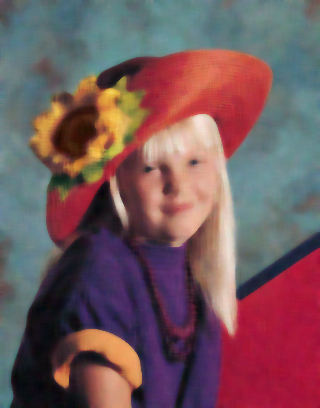

In [ ]:
median_rgb=cv2.medianBlur(image_noize,9)
median_rgb

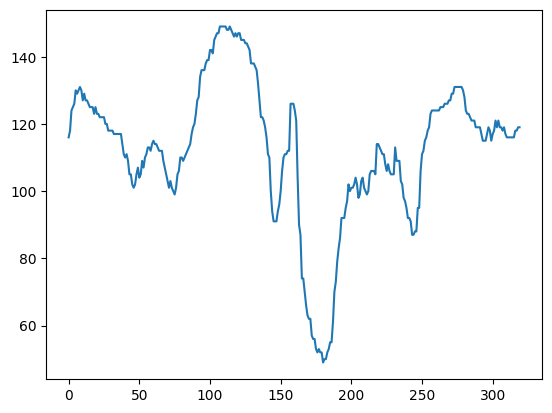

In [ ]:
r,g,b = cv2.split(median_rgb)
plt.plot(g[56])

array([[[100,  80,  93],
        [ 98,  80,  93],
        [ 96,  80,  92],
        ...,
        [110,  87,  85],
        [112,  87,  84],
        [112,  87,  84]],

       [[ 99,  80,  92],
        [ 97,  80,  92],
        [ 95,  79,  91],
        ...,
        [110,  88,  85],
        [112,  87,  85],
        [112,  87,  85]],

       [[ 96,  79,  90],
        [ 95,  79,  90],
        [ 93,  79,  89],
        ...,
        [109,  89,  86],
        [111,  89,  86],
        [111,  89,  86]],

       ...,

       [[ 75, 114, 125],
        [ 75, 115, 125],
        [ 75, 118, 125],
        ...,
        [163,  18,  53],
        [162,  17,  53],
        [161,  17,  52]],

       [[ 74, 112, 126],
        [ 74, 114, 126],
        [ 74, 117, 126],
        ...,
        [163,  18,  53],
        [162,  17,  52],
        [161,  16,  52]],

       [[ 74, 112, 127],
        [ 73, 113, 127],
        [ 73, 116, 126],
        ...,
        [163,  18,  53],
        [162,  16,  52],
        [161,  15,  51]]], dtype=uint8)
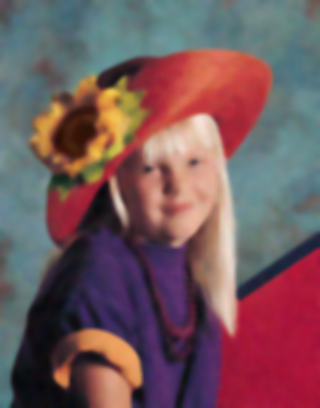

In [ ]:
gausian_rgb=cv2.GaussianBlur(median_rgb,[5,5],3)
gausian_rgb

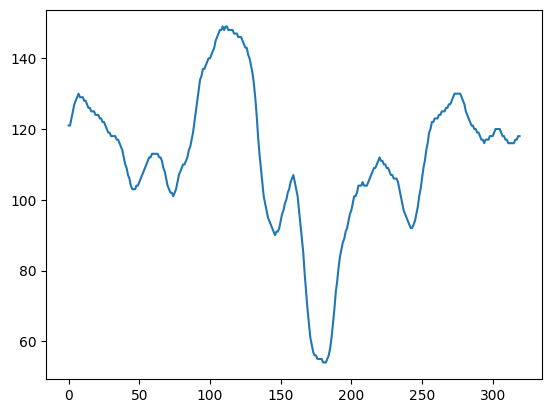

In [ ]:
r,g,b = cv2.split(gausian_rgb)
plt.plot(g[56])

Как можно видеть, значения после Фильтра Гауса становятся намного лучше, чем после Медианнаго фильтра. Это говорит нам о том, что каждый фильтр наиболее эффективен для своего вида шума.

Перейдем к больбе с проблемами освещения.

array([[144, 141, 141, ..., 128, 128, 128],
       [142, 143, 144, ..., 128, 128, 128],
       [142, 142, 140, ..., 128, 128, 128],
       ...,
       [172, 166, 168, ..., 178, 175, 170],
       [166, 167, 167, ..., 171, 172, 175],
       [166, 168, 167, ..., 174, 175, 174]], dtype=uint8)
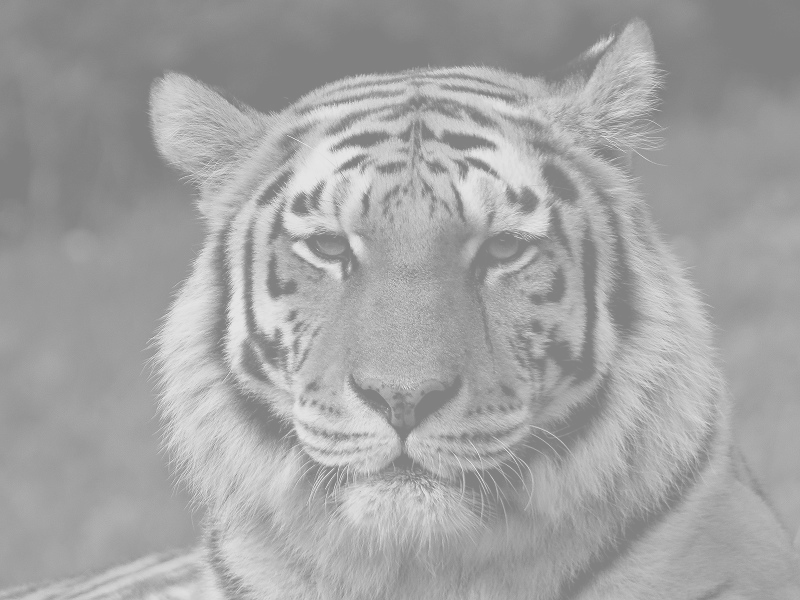

In [ ]:
image_noize=cv2.imread('/content/drive/MyDrive/Colab Notebooks/Данные_CV/tiger.png')
image_lig = cv2.cvtColor(image_noize, cv2.COLOR_BGRA2GRAY)
image_lig

Функция matplotlib.pyplot.hist используется для построения гистограммы массива чисел. Для использования функции с изображениями массив нужно вытянуть в одномерный с помощью метода ravel. С помощью аргумента bins задается количество или границы корзин гистограммы.

Функция построения гистограммы возвращает кортеж из трех элементов — значений гистограммы, границы корзин и отдельные прямоугольники, использовавшиеся для построения гистограммы.

array([144, 141, 141, ..., 174, 175, 174], dtype=uint8)

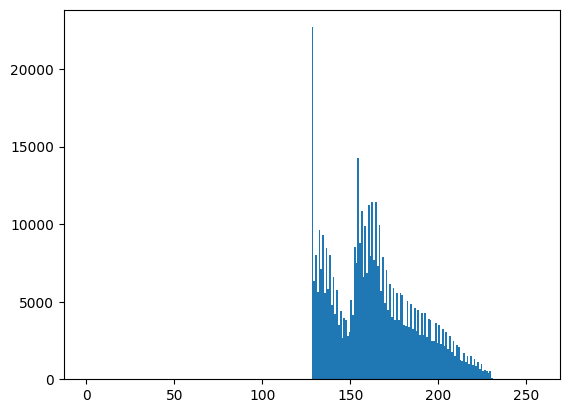

In [ ]:
from matplotlib.pyplot import hist
values, bin_edges, patches = hist(image_lig.ravel(), bins=range(257))
image_lig.ravel()

Для поиска максимального и минимального значений массива в NumPy используйте функции numpy.max() и numpy.min(). Например, для массива arr вы найдете максимум с помощью np.max(arr) и минимум с помощью np.min(arr)

In [ ]:
max=np.max(image_lig)
max

np.uint8(230)

In [ ]:
min=np.min(image_lig)
min

np.uint8(128)

Используя данные функции мы с вами легко убеждаемся, что значения освещенности нашего изображения находяться в очень узком диапазоне значений, что конечно же плохо. Давайте применим коррекцию освещения, в частности линейный фильтр освещения (линейную коррекцию). Оформим данную информацию в виде функции на вход которой будем подавать исключительно изображение а на выходе получать новое изображение

In [ ]:
def linear_correction (image):
  new_image=np.zeros(image.shape,dtype='uint8')
  max=np.max(image)
  min=np.min(image)
  for i in range(len(image)):
    for j in range(len(image[i])):
      new_image[i,j]=(image[i,j]-min)*(255/(max-min))
  return new_image

array([[ 40,  32,  32, ...,   0,   0,   0],
       [ 35,  37,  40, ...,   0,   0,   0],
       [ 35,  35,  30, ...,   0,   0,   0],
       ...,
       [110,  95, 100, ..., 125, 117, 105],
       [ 95,  97,  97, ..., 107, 110, 117],
       [ 95, 100,  97, ..., 115, 117, 115]], dtype=uint8)
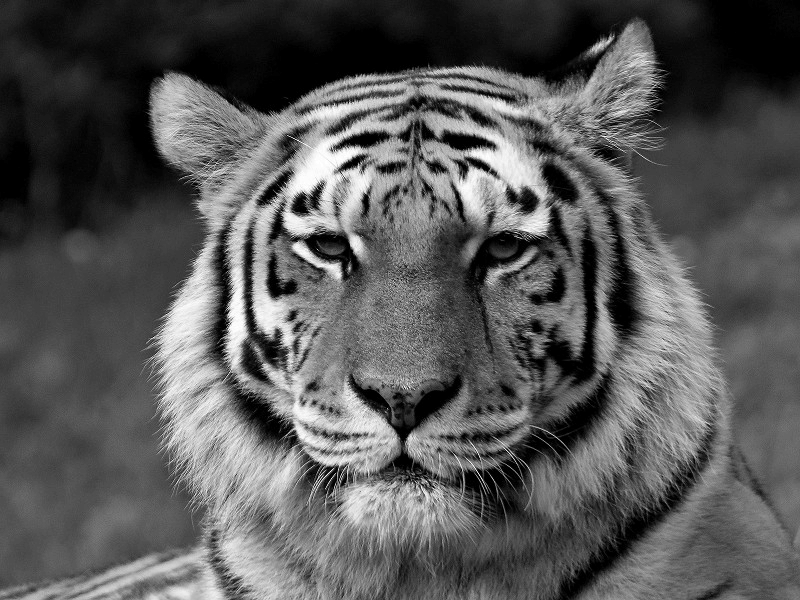

In [ ]:
img_cor=linear_correction(image_lig)
img_cor

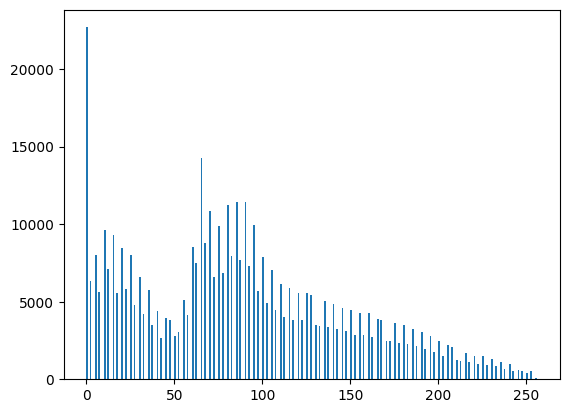

In [ ]:
values, bin_edges, patches = hist(img_cor.ravel(), bins=range(257))

Давайте рассмотрим немного более сложный пример

array([[  1,   1,   1, ...,  62,  62,  63],
       [  1,   1,   1, ...,  60,  58,  58],
       [  1,   1,   1, ...,  57,  53,  52],
       ...,
       [ 39,  47,  50, ..., 122, 114, 105],
       [ 37,  47,  51, ..., 119, 112, 105],
       [ 35,  45,  49, ..., 112, 109, 108]], dtype=uint8)
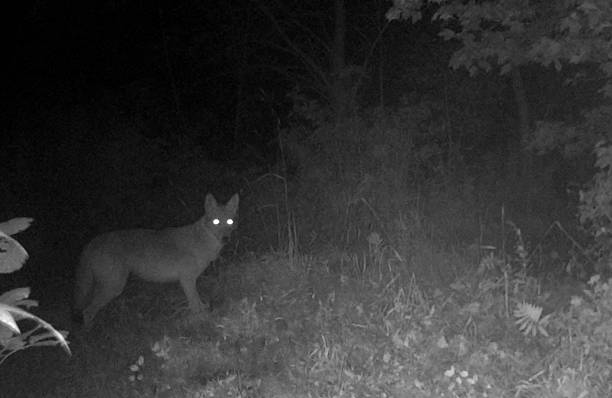

In [ ]:
image_noize=cv2.imread('/content/drive/MyDrive/Colab Notebooks/Данные_CV/1.jpg')
image_lig = cv2.cvtColor(image_noize, cv2.COLOR_BGRA2GRAY)
image_lig

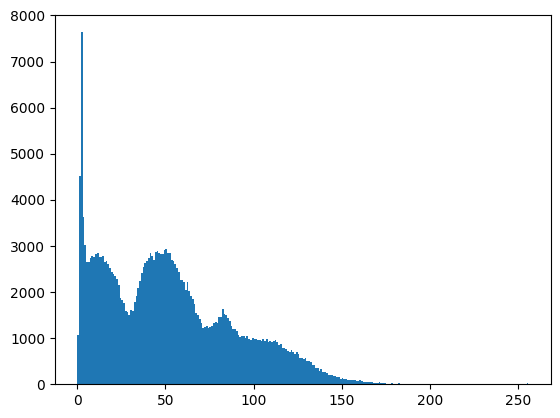

In [ ]:
values, bin_edges, patches = hist(image_lig.ravel(), bins=range(257))

In [ ]:
max=np.max(image_lig)
min=np.min(image_lig)
max , min

(np.uint8(255), np.uint8(0))

У нас появилась проблема, все дело в том, что оказывается, на гистограмме плохо видно, но в области 255 значений у нас имеються тоже точки. То есть используя линейную коррекцию, у нас ничего не изменится! Что же делать? Нужно изменить правила выбора границ! Выбрать не единичные точки (минимальную и максимальную), а статистические границы, например область 5 процентов. \

In [ ]:
k=round(np.max(values)*0.05)
values-k
new_arr = np.clip(values-k, a_min=0, a_max=1000)
np.where(new_arr == 0)[0][0]


np.int64(135)

И так теперь нам надо модифицировать нашу функцию коррекции и посмотреть что будет после применения

In [ ]:
def linear_correction_new (image):
  values, bin_edges = np.histogram(image, bins=range(255))
  k=round(np.max(values)*0.05)
  values-k
  new_arr = np.clip(values-k, a_min=0, a_max=1000)
  max=np.where(new_arr == 0)[0][0]
  new_image=np.zeros(image.shape,dtype='uint8')
  min=np.min(image)
  for i in range(len(image)):
    for j in range(len(image[i])):
      new_image[i,j]=np.clip((image[i,j]-min)*(255/(max-min)),a_min=0, a_max=255)
  return new_image

array([[  1,   1,   1, ...,  62,  62,  63],
       [  1,   1,   1, ...,  60,  58,  58],
       [  1,   1,   1, ...,  57,  53,  52],
       ...,
       [ 39,  47,  50, ..., 122, 114, 105],
       [ 37,  47,  51, ..., 119, 112, 105],
       [ 35,  45,  49, ..., 112, 109, 108]], dtype=uint8)
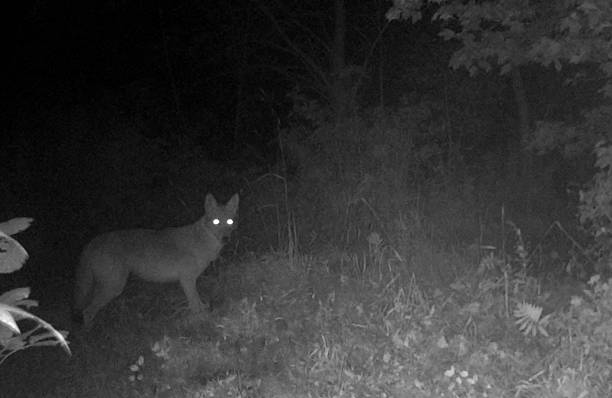

In [ ]:
img_cor=linear_correction_new(image_lig)
image_lig

array([[  1,   1,   1, ..., 117, 117, 119],
       [  1,   1,   1, ..., 113, 109, 109],
       [  1,   1,   1, ..., 107, 100,  98],
       ...,
       [ 73,  88,  94, ..., 230, 215, 198],
       [ 69,  88,  96, ..., 224, 211, 198],
       [ 66,  85,  92, ..., 211, 205, 204]], dtype=uint8)
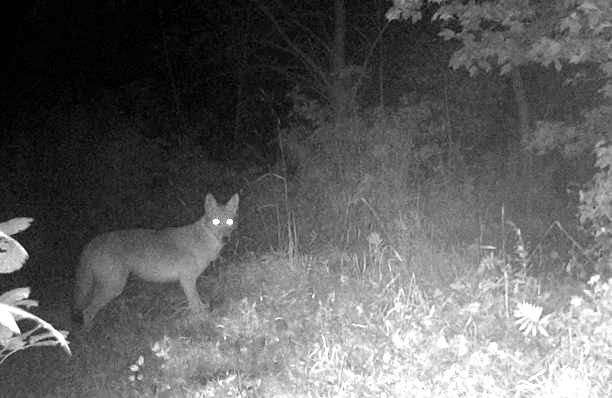

In [ ]:
img_cor

В функции написанной мною, есть один изьян. Определите его и скорректируйте функцию, для верного использования.

# Практика 3. Работа с контурами

И так, одним из типов информации на ряду с цветом являются границы или контура объектов. Этот тип информации важен поскольку для понимания, что за ТИП объекта перд нами расположен в большенстве случаев контура достаточно для человека. Поскольку граница это в большенстве случаев перепад яркости/цвета на изображении. ТО мы как раз рассмотрим 2 основных варианта нахождения данных границ. Во-первых, это оператор Лапласа, который берез свою суть, напрямую от нахождения производной. Во-вторых, это оператор Собеля, он тоже имеет тот же физический смысл, однако

In [ ]:
img_canny = cv2.Canny(img2, 100, 140) # (изображение, порог1, порог2) пороги - точность определения
img_canny

NameError: name 'img2' is not defined

In [ ]:
result = list(map(lambda x, y: x + y, [1, 2, 3], [4, 5, 6]))
print(result)

In [ ]:
con, hier = cv2.findContours(img_canny, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
new_img = np.zeros(RGB.shape, dtype='uint8') #
cv2.drawContours(RGB, con, -1, (0,255,0), 3)

for i in con:
  cv2.drawContours(new_img, i, 0, (0,255,0), 3)
RGB

In [ ]:
new_img

# Практика 4. Работа с видеопотоком.

Как уже говорилось, по сути видео поток, или видео файл состоит из последовательного набора изображений. ПОэтому с одной стороны методы применяемые для обработки одного изображения. Ссылка на видео:https://drive.google.com/file/d/1VjEzkX0AdpEU3qW9FW_f4133NFQ6iPsf/view?usp=sharing


array([[[ 7, 41,  4],
        [ 7, 41,  4],
        [ 7, 41,  4],
        ...,
        [10, 29,  0],
        [10, 29,  0],
        [10, 29,  0]],

       [[ 7, 41,  4],
        [ 7, 41,  4],
        [ 7, 41,  4],
        ...,
        [10, 29,  0],
        [10, 29,  0],
        [10, 29,  0]],

       [[ 7, 41,  4],
        [ 7, 41,  4],
        [ 7, 41,  4],
        ...,
        [10, 29,  0],
        [10, 29,  0],
        [10, 29,  0]],

       ...,

       [[19, 49, 12],
        [19, 49, 12],
        [19, 49, 12],
        ...,
        [15, 28,  0],
        [15, 28,  0],
        [15, 28,  0]],

       [[19, 49, 12],
        [19, 49, 12],
        [19, 49, 12],
        ...,
        [15, 28,  0],
        [15, 28,  0],
        [15, 28,  0]],

       [[19, 49, 12],
        [19, 49, 12],
        [19, 49, 12],
        ...,
        [15, 28,  0],
        [15, 28,  0],
        [15, 28,  0]]], dtype=uint8)
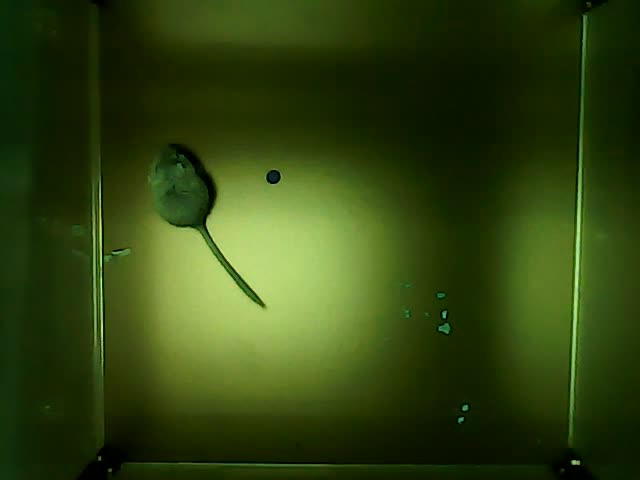

In [ ]:
import cv2
import numpy as np
cap = cv2.VideoCapture('/content/drive/MyDrive/mouse_1.avi')
success, img3 = cap.read()
img3

И так, давайте сделаем следующее, преобразуем наш видеофайл в последовательность ищзображений. Обычно такой возможности нет, поскольку видео с камеры приходит последовательно. Однако в данном примере в Colabe последовательная обработка дело не совсем удобное и потому, на первых шагах мы остановимся на подобном методе обработка. Что нужно сделать? Давайте пробежимся по всему файлу и запишем наши изображения в массив.

In [ ]:
i=1
success = True
imgs = []
print(i)
while (success == True):
  print(i)
  success, img = cap.read()
  img_grey=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
  imgs.append(img_grey)
  i=i+1
i

Выходные данные были обрезаны до нескольких последних строк (5000).
1077
1078
1079
1080
1081
1082
1083
1084
1085
1086
1087
1088
1089
1090
1091
1092
1093
1094
1095
1096
1097
1098
1099
1100
1101
1102
1103
1104
1105
1106
1107
1108
1109
1110
1111
1112
1113
1114
1115
1116
1117
1118
1119
1120
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130
1131
1132
1133
1134
1135
1136
1137
1138
1139
1140
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
1181
1182
1183
1184
1185
1186
1187
1188
1189
1190
1191
1192
1193
1194
1195
1196
1197
1198
1199
1200
1201
1202
1203
1204
1205
1206
1207
1208
1209
1210
1211
1212
1213
1214
1215
1216
1217
1218
1219
1220
1221
1222
1223
1224
1225
1226
1227
1228
1229
1230
1231
1232
1233
1234
1235
1236
1237
1238
1239
1240
1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
1251
1252
1253
1254
1255
1256
1257
1258
1259
1260
1261
1262
12

error: OpenCV(4.12.0) /io/opencv/modules/imgproc/src/color.cpp:199: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


Теперь, когда нам удалось собрать все данные в массив, мы можем обраться к любому элементу массива и вывести соответствующую фотку на экран

array([[78, 77, 76, ..., 59, 58, 58],
       [74, 74, 73, ..., 59, 58, 58],
       [71, 71, 72, ..., 58, 57, 57],
       ...,
       [81, 81, 81, ..., 53, 53, 53],
       [81, 81, 81, ..., 53, 53, 53],
       [81, 81, 81, ..., 53, 53, 53]], dtype=uint8)
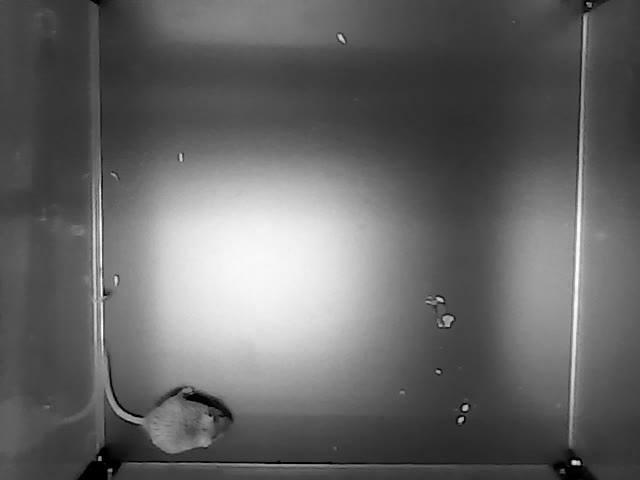

In [ ]:
imgs[4000]

Задача нашей практики определить движение мышки на видео и построить траекторию ее движения. Поскольку мышка движеться в постоянном фоне, наилучшим решением данной задачи будет являться метод построения модели фона. Для начала реализуем самый простой метод. А именно метод усреднения фона. Данный метод в реальных условиях не возможен (ну или мало возможен), поскольку для него необходимо усреднить пиксели всех кадров, но в нашем примере такая информация нам сразу доступна. Для начала посмотрим функцию сложения изображений попиксельно.

In [ ]:
def sr_mod_fon (arr_image):
  mod_fon = np.zeros(arr_image[1].shape, dtype='uint8')
  sum=np.zeros([480,640])
  for k in range(len(arr_image)-10):
    image=arr_image[k]
    for i in range(len(image)):
      for j in range(len(image[i])):
        sum[i,j]=sum[i,j]+image[i,j]
    print(k)

  sum=sum/k
  return sum


Данная функция складывает значения пикселей, которые занимают одно и тоже пространственное расположение. А после прохода по всему массиву береться среднее от количества изображений.

In [ ]:
amt=sr_mod_fon(imgs)
amt

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

KeyboardInterrupt: 

Поскольку на выходе мы получаем не целые значения пикселей, то их нужно округлить. Для это воспользуемся функцией библиотеки np для перевода в требуемый формат изображения, а именно np.uint8

array([[71, 71, 71, ..., 58, 57, 57],
       [71, 71, 71, ..., 58, 57, 57],
       [71, 71, 71, ..., 58, 58, 57],
       ...,
       [81, 81, 80, ..., 52, 52, 52],
       [81, 80, 80, ..., 52, 52, 52],
       [81, 80, 80, ..., 52, 52, 52]], dtype=uint8)
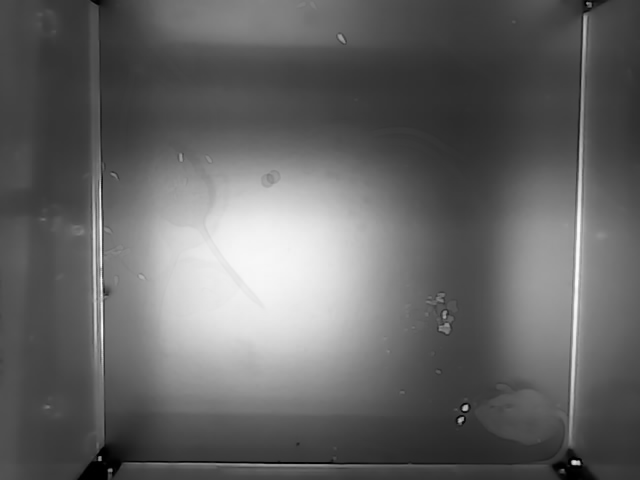

In [ ]:
new=np.uint8(amt)
new

ПО итогу, нам удалось получить карту фона, полученную усреднением. Мы видим, что на карте видно кортур мышки в 2-х местах. Это происходит потому, что мышка в этих местазх достаточно долго сидит и не двигается. Это затрудняет определение. ПОэтому вычитание пикселей между картой фона и изображением (для примера возьмем 2000-чное) мы будем использовать пороговую бинаризацию по разнице.

array([[67, 67, 68, ..., 56, 56, 56],
       [68, 68, 68, ..., 56, 56, 56],
       [70, 70, 69, ..., 56, 56, 56],
       ...,
       [77, 77, 77, ..., 49, 49, 49],
       [77, 77, 77, ..., 49, 49, 49],
       [77, 77, 77, ..., 49, 49, 49]], dtype=uint8)
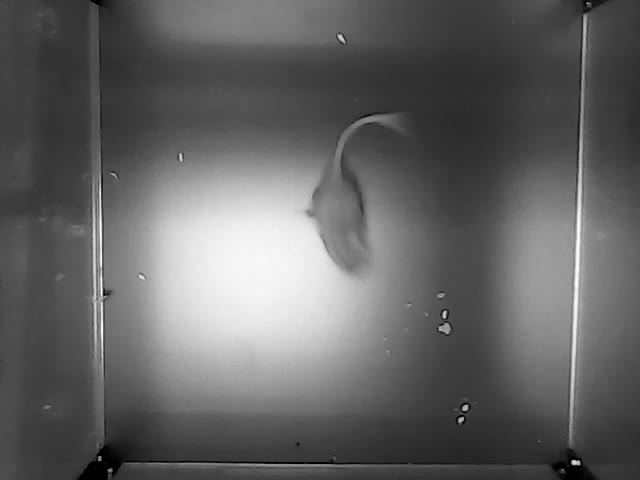

In [ ]:
imgs[2005]

Добавляем вычитание текущего кадра от фона.

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)
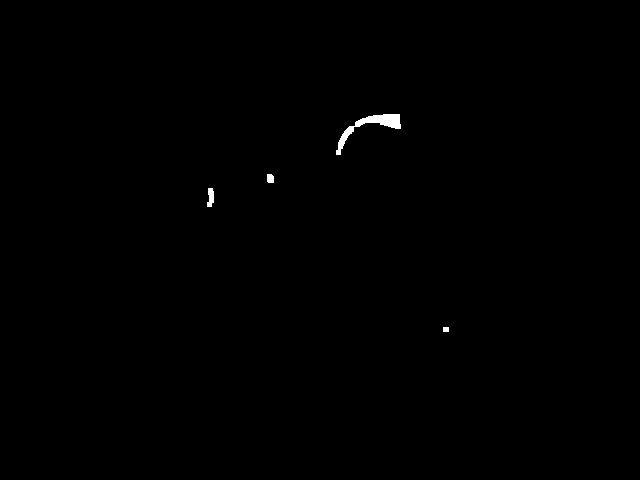

In [ ]:
diff_image=cv2.addWeighted(imgs[2005],1,new,-1,0)
ret,thresh = cv2.threshold(diff_image, 20, 255,cv2.THRESH_BINARY)
thresh=cv2.morphologyEx(thresh, cv2.MORPH_OPEN, np.ones((5,5),np.uint8), iterations=1)
thresh=cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, np.ones((5,5),np.uint8), iterations=1)

thresh

С учетом использования порога, нам удалось получить пиксели, которые относяться к мышке, хоть и не очень хорошо. Осталось найти ее центр масс. Для этого используем функцию нахождения моментов.

In [ ]:
mu=cv2.moments(thresh)
mc = (mu['m10'] / (mu['m00'] + 1e-5), mu['m01'] / (mu['m00'] + 1e-5))
mc

(345.8019680030002, 145.90282902125256)

С учетом использования порога, нам удалось получить пиксели, которые относяться к мышке, хоть и не очень хорошо. Осталось найти ее центр масс. Для этого используем функцию нахождения моментов. Для отрисовки точки воспользуемся функцией circle от opencv


In [ ]:
image_test=cv2.copyTo(imgs[2005],imgs[2005])
cv2.circle(image_test,(int(mc[0]), int(mc[1])), 5, (0,0,255), -1)

NameError: name 'cv2' is not defined

Мы смогли определить координаты точки мышки и вывести на экран. ПОлучилось примерно верно. Теперь самостоятельно примените данную операцию ко всему видеофайлу и посмотрите результат. Посмотрим другие алгоритмы определения модели фона. Используем концепцию обновляемого фона.

In [ ]:
def mod_fon (arr_image):
  mod_fon = np.zeros(arr_image[1].shape, dtype='uint8')
  mom=[None]*len(arr_image)
  for k in range(len(arr_image)-10):
    mod_fon=cv2.addWeighted(arr_image[k],0.5,mod_fon,0.5,0)
    diff_image=cv2.addWeighted(arr_image[k],1,mod_fon,-1,0)
    ret,thresh = cv2.threshold(diff_image, 20, 255,cv2.THRESH_BINARY)
    mu=cv2.moments(thresh)
    mom[k]=(mu['m10'] / (mu['m00'] + 1e-5), mu['m01'] / (mu['m00'] + 1e-5))
    if(mom[k][0]==0 and mom[k][1]==0):
      mom[k]=mom[k-1]
    if(k!=0):
      if((mom[k][0]-mom[k-1][0])>30 or (mom[k][1]-mom[k-1][1])>30):
        mom[k]=mom[k-1]
  return mom

In [ ]:
data=mod_fon(imgs)
data[10][1]

212.99999164705915

In [ ]:
data

NameError: name 'data' is not defined

array([[33, 33, 33, ..., 28, 28, 28],
       [33, 33, 33, ..., 27, 27, 27],
       [33, 33, 33, ..., 27, 27, 27],
       ...,
       [42, 42, 42, ..., 19, 19, 19],
       [42, 42, 42, ..., 19, 19, 19],
       [42, 42, 42, ..., 19, 19, 19]], dtype=uint8)
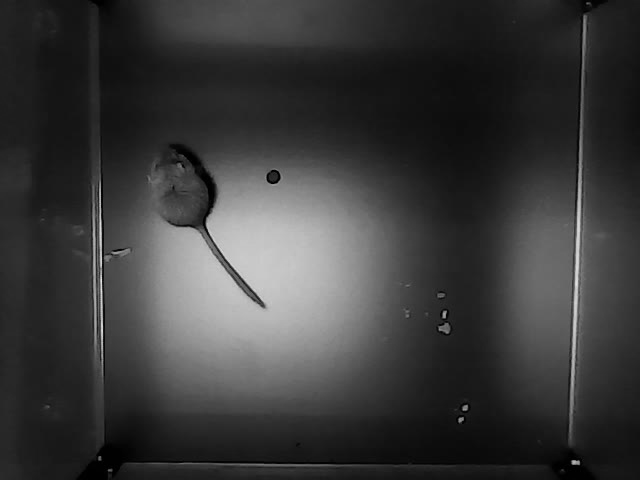

In [ ]:
imgs[0]

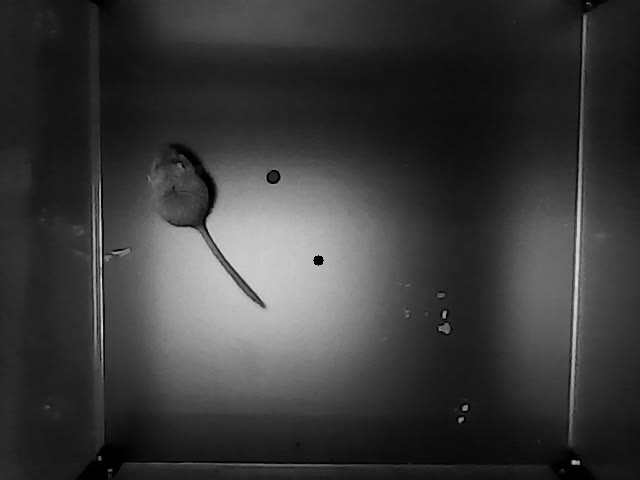

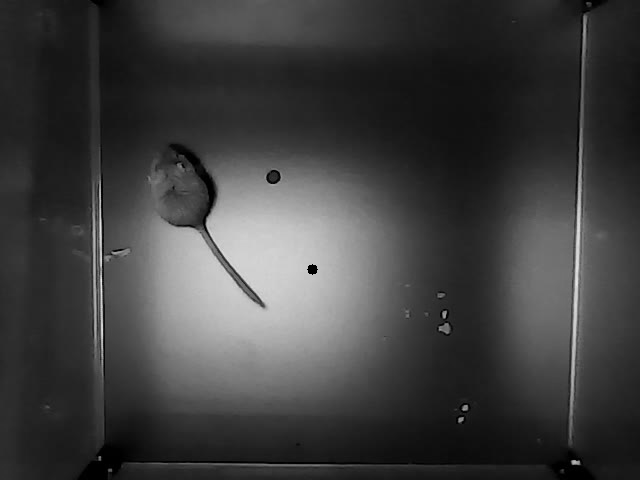

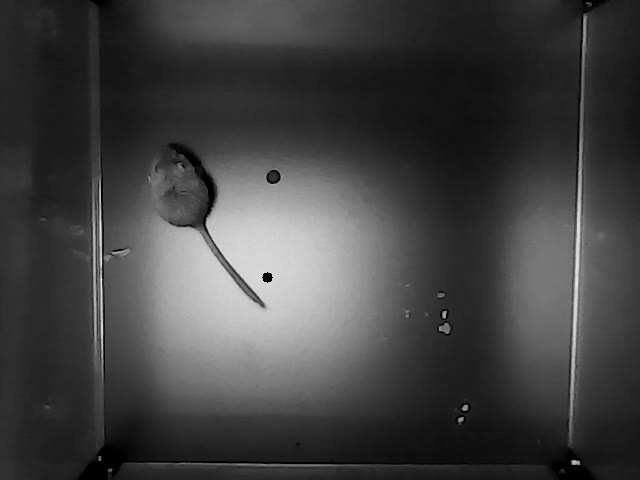

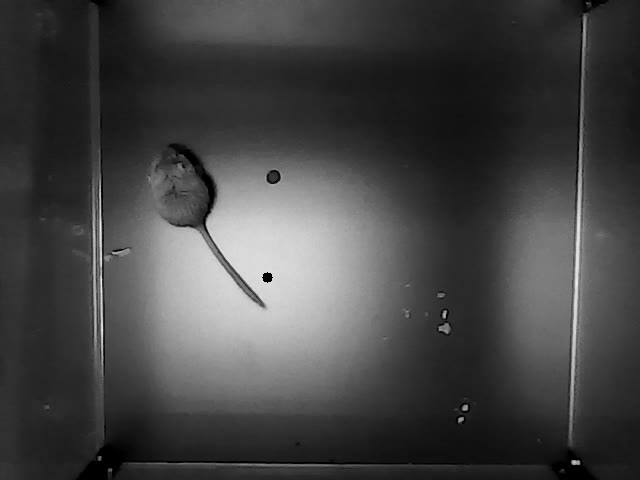

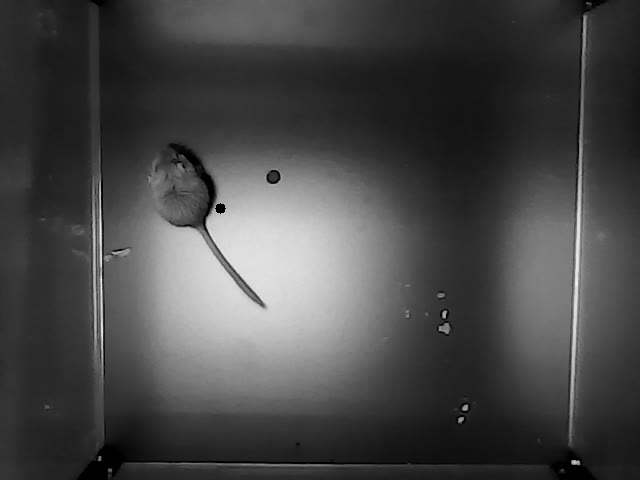

...

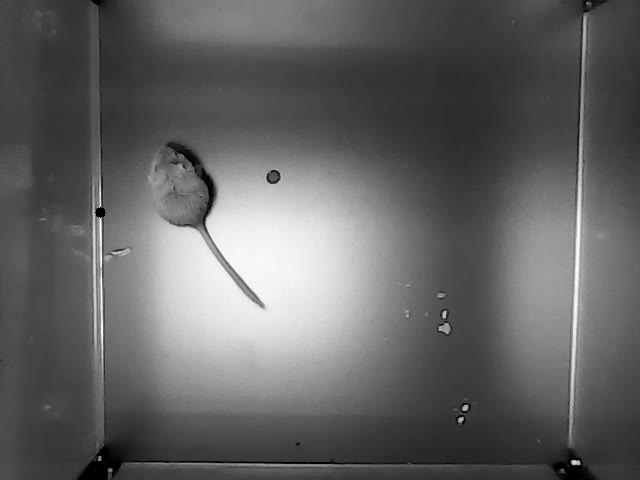

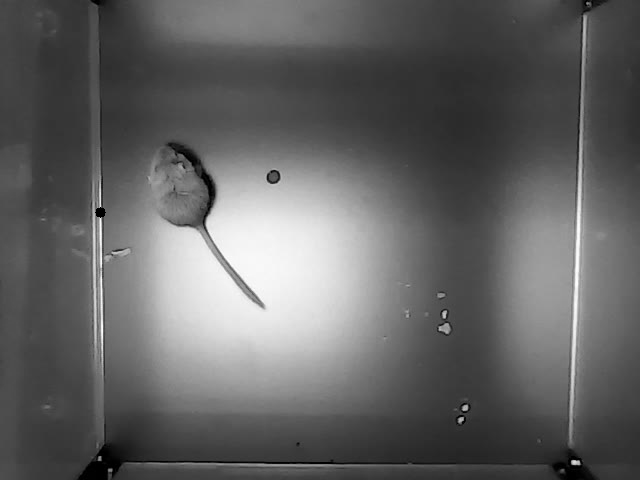

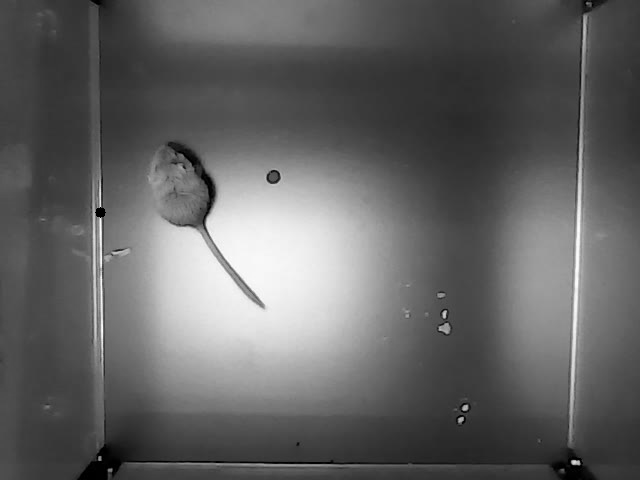

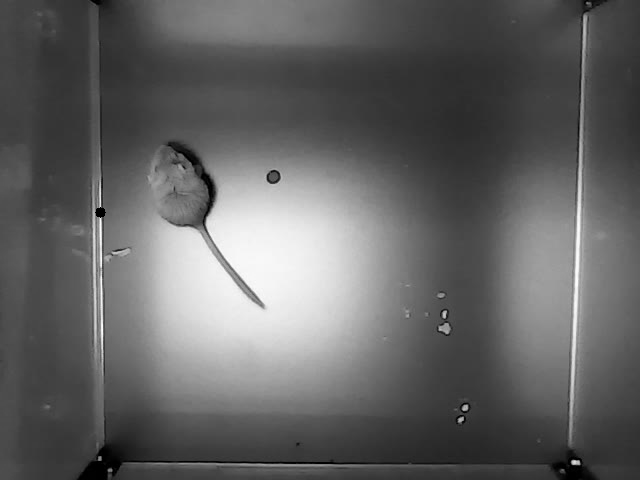

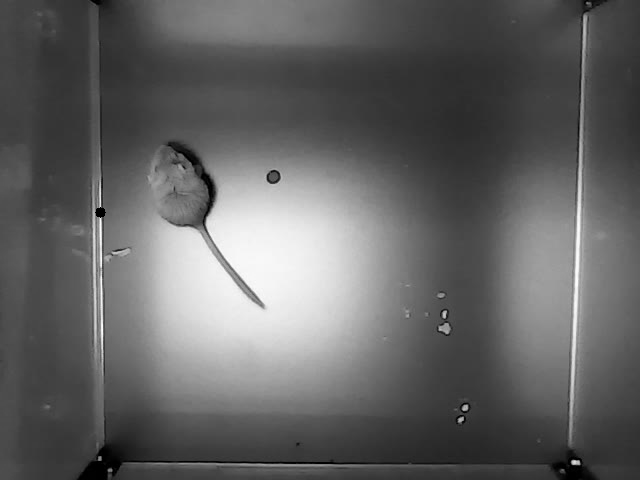

KeyboardInterrupt: 

In [ ]:
from google.colab.patches import cv2_imshow
for k in range(len(imgs)-10):
  image_test=cv2.copyTo(imgs[k],imgs[k])
  cv2.circle(image_test,(int(data[k][0]), int(data[k][1])), 5, (0,0,255), -1)
  cv2_imshow(image_test)

И так мы практически полностью решили задачу. Осталось вывести траекторию движения на экран

In [ ]:
len(data)

6075

In [ ]:
D1=[None]*len(data)
D2=[None]*len(data)
for k in range(len(data)-10):
  print(k)
  D1[k] = data[k][0]
  D2[k] = data[k][1]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

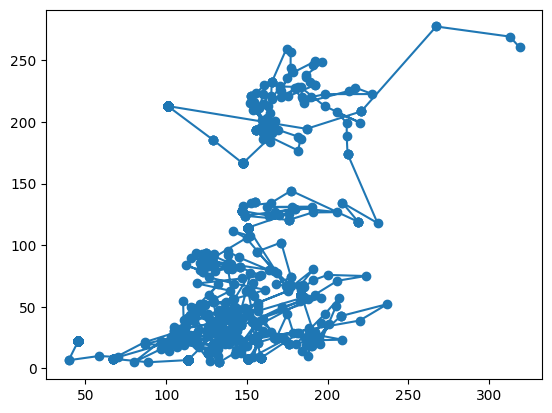

In [ ]:
import matplotlib.pyplot as plt
plt.plot(D1, D2, marker='o')

# Практика 5. реализация сверточных нейронных сетей, для задачи классификации

In [ ]:
import cv2

In [ ]:
cv2.resize(image, (480, 480))